In [3]:
import os
import pandas as pd
import torch



In [4]:
DATA='./data/naver_shopping.txt'
with open(DATA, 'r', encoding='utf-8') as file:
    lines = file.readlines()
    for line in lines:
        print(line.strip())

5	배공빠르고 굿
2	택배가 엉망이네용 저희집 밑에층에 말도없이 놔두고가고
5	아주좋아요 바지 정말 좋아서2개 더 구매했어요 이가격에 대박입니다. 바느질이 조금 엉성하긴 하지만 편하고 가성비 최고예요.
2	선물용으로 빨리 받아서 전달했어야 하는 상품이었는데 머그컵만 와서 당황했습니다. 전화했더니 바로주신다했지만 배송도 누락되어있었네요.. 확인안하고 바로 선물했으면 큰일날뻔했네요..이렇게 배송이 오래걸렸으면 사는거 다시 생각했을거같아요 아쉽네요..
5	민트색상 예뻐요. 옆 손잡이는 거는 용도로도 사용되네요 ㅎㅎ
2	비추합니다 계란 뒤집을 때 완전 불편해요 ㅠㅠ 코팅도 묻어나고 보기엔 예쁘고 실용적으로 보였는데 생각보다 진짜 별로입니다.
1	주문을 11월6에 시켰는데 11월16일에 배송이 왔네요 ㅎㅎㅎ 여기 회사측과는 전화도 안되고 아무런 연락을 받을수가 없으니 답답하신 분들은 다른곳에서 사시는거 추천드립니다
2	넉넉한 길이로 주문했는데도 안 맞네요 별로예요
2	보폴이 계속 때처럼 나오다가 지금은 안나네요~
2	110인데 전문속옷브랜드 위생팬티105보다 작은듯해요. 불편해요. 밴딩부분이 다 신축성없는 일반실로 되어있어 빅사이즈임에도 빅사이즈같지않아요. 입고벗을때 편하게 밴딩부분이 늘어나고 입었을때도 밴딩이 잡아주어야하는데 말이죠.
5	사이즈도 딱이고 귀엽고 넘 좋아요 ㅎㅎ
2	베이지 색 구매했는데 약간 살색에 가까워요
2	화면빨인가봐요;; 노란컬러가 돋보여요;; 저렴한맛에 그냥 씁니다
2	별루 ㅏㅛㅇ치ㅗ티ㅓ치ㅗ탛캏타ㅗ티ㅗ티ㅗ티ㅛ티ㅛ티ㅗㅗㅗ치ㅕ치ㅕ쳐ㅣ처ㅣ치ㅓ처ㅣ펴ㅣ쳐ㅣ치ㅕㅐㅛㅌ쵸ㅔ려ㅔㅎ
5	촉감도 좋고 무게감이나 핏도 편합니다
5	불멍하기좋고 사이즈도 너무 좋아요
5	재구매 친구들이 좋은 향 난다고 해요
1	실내에서 신는건지 몰랐어요
4	재구매 다 좋은데 하나가 이상하네요
5	가게를 운영하는 사장님께서 대신 구매 해달라고 하셔서 구매하게되었는데 가게에 달아놓으니까 이쁘네요
4	가성비 괜찮습니다 바퀴가 고정된다면 별다섯개짜린데...
2	화장이 깨끗하게 지워지지않아요 

In [5]:
text = []
cnt = []
for line in lines:
    text.append(line.strip()[1:])
    cnt.append(line.strip()[0])


In [6]:
dataDF = pd.DataFrame(text)
dataDF['cnt'] = cnt
dataDF.columns = ['text', 'target']
dataDF

,text,target
0,\t배공빠르고 굿,5
1,\t택배가 엉망이네용 저희집 밑에층에 말도없이 놔두고가고,2
2,\t아주좋아요 바지 정말 좋아서2개 더 구매했어요 이가격에 대박입니다. 바느질이 조...,5
3,\t선물용으로 빨리 받아서 전달했어야 하는 상품이었는데 머그컵만 와서 당황했습니다....,2
4,\t민트색상 예뻐요. 옆 손잡이는 거는 용도로도 사용되네요 ㅎㅎ,5
...,...,...
199995,\t장마라그런가!!! 달지않아요,2
199996,\t다이슨 케이스 구매했어요 다이슨 슈퍼소닉 드라이기 케이스 구매했어요가격 괜찮고 ...,5
199997,\t로드샾에서 사는것보다 세배 저렴하네요 ㅜㅜ 자주이용할께요,5
199998,\t넘이쁘고 쎄련되보이네요~,5


In [7]:
dataDF['target'] = dataDF['target'].isin(['4','5']).astype(int)
dataDF

,text,target
0,\t배공빠르고 굿,1
1,\t택배가 엉망이네용 저희집 밑에층에 말도없이 놔두고가고,0
2,\t아주좋아요 바지 정말 좋아서2개 더 구매했어요 이가격에 대박입니다. 바느질이 조...,1
3,\t선물용으로 빨리 받아서 전달했어야 하는 상품이었는데 머그컵만 와서 당황했습니다....,0
4,\t민트색상 예뻐요. 옆 손잡이는 거는 용도로도 사용되네요 ㅎㅎ,1
...,...,...
199995,\t장마라그런가!!! 달지않아요,0
199996,\t다이슨 케이스 구매했어요 다이슨 슈퍼소닉 드라이기 케이스 구매했어요가격 괜찮고 ...,1
199997,\t로드샾에서 사는것보다 세배 저렴하네요 ㅜㅜ 자주이용할께요,1
199998,\t넘이쁘고 쎄련되보이네요~,1


In [8]:
dataDF['target'].value_counts()

target
0    100037
1     99963
Name: count, dtype: int64

In [9]:
train = dataDF.sample(frac=0.9, random_state=42)
test= dataDF.drop(train.index)

In [10]:
print(train.head(5).to_markdown())

|        | text                                                                                               |   target |
|-------:|:---------------------------------------------------------------------------------------------------|---------:|
| 119737 | 마감이 안좋아요...실밥도 많고 바느질도 부족한 부분이 몇군데 있네요...교환받기 귀찮아서 그냥 씁니다 |        0 |
|  72272 | 깨끗하게 잘 다듬어져 있어요. 맛도좋고요.                                                           |        1 |
| 158154 | 재구매 배송빨라요 길냥이들이 잘먹어요~~ 대용량이라 좋네요~                                         |        1 |
|  65426 | 제품도 빨리 배송해주시고 꼼꼼하게 잘챙겨주셨어요                                                   |        1 |
|  30074 | 기타 남 멋지고 예뻐요 여러 사은품도 좋아요                                                         |        1 |


In [11]:
print('Training Data Size : ', len(train))
print('Testing Data Size : ', len(test))

Training Data Size :  180000
Testing Data Size :  20000


#### 데이터 토큰화 및 단어사전 구축

In [12]:
from konlpy.tag import *
from collections import Counter

In [13]:
def build_vocab(corpus, n_vocab, special_tokens):
    counter = Counter()
    for tokens in corpus:
        counter.update(tokens)
    vocab = special_tokens
    for token, count in counter.most_common(n_vocab):
        vocab.append(token)
    return vocab

In [12]:
stopword_path = 'basic_ko_stopwords.txt'
with open(stopword_path, 'r', encoding='utf-8') as file:
    word = file.readlines()

In [13]:
words = list(map(lambda x:x.replace('\n',''), word))

['ㄱ',
 'ㄴ',
 'ㄷ',
 'ㄹ',
 'ㅁ',
 'ㅂ',
 'ㅅ',
 'ㅇ',
 'ㅈ',
 'ㅊ',
 'ㅋ',
 'ㅌ',
 'ㅍ',
 'ㅎ',
 'ㄲ',
 'ㄸ',
 'ㅃ',
 'ㅆ',
 'ㅉ',
 'ㅏ',
 'ㅑ',
 'ㅓ',
 'ㅑ',
 'ㅗ',
 'ㅛ',
 'ㅜ',
 'ㅠ',
 'ㅡ',
 'ㅣ',
 'ㅐ',
 'ㅒ',
 'ㅔ',
 'ㅖ',
 'ㅚ',
 'ㅟ',
 'ㅘ',
 'ㅝ',
 'ㅢ',
 '가',
 '나',
 '다',
 '라',
 '마',
 '바',
 '사',
 '아',
 '자',
 '차',
 '카',
 '타',
 '파',
 '하',
 '까',
 '따',
 '빠',
 '싸',
 '짜',
 '갸',
 '냐',
 '댜',
 '랴',
 '먀',
 '뱌',
 '샤',
 '야',
 '쟈',
 '챠',
 '캬',
 '탸',
 '퍄',
 '햐',
 '꺄',
 '땨',
 '뺘',
 '쌰',
 '쨔',
 '거',
 '너',
 '더',
 '러',
 '머',
 '버',
 '서',
 '어',
 '저',
 '처',
 '커',
 '터',
 '퍼',
 '허',
 '꺼',
 '떠',
 '뻐',
 '써',
 '쩌',
 '겨',
 '녀',
 '뎌',
 '려',
 '며',
 '벼',
 '셔',
 '여',
 '져',
 '쳐',
 '켜',
 '텨',
 '펴',
 '혀',
 '껴',
 '뗘',
 '뼈',
 '쎠',
 '쪄',
 '고',
 '노',
 '도',
 '로',
 '모',
 '보',
 '소',
 '오',
 '조',
 '초',
 '코',
 '토',
 '포',
 '호',
 '꼬',
 '또',
 '뽀',
 '쏘',
 '쪼',
 '교',
 '뇨',
 '됴',
 '료',
 '묘',
 '뵤',
 '쇼',
 '요',
 '죠',
 '쵸',
 '쿄',
 '툐',
 '표',
 '효',
 '꾜',
 '뚀',
 '뾰',
 '쑈',
 '쬬',
 '구',
 '누',
 '두',
 '루',
 '무',
 '부',
 '수',
 '우',
 '주',
 '추',
 '쿠',
 '투',
 '푸',
 '후',
 '꾸'

In [14]:
import re

def getToken(textlist,tokenizer):
    """한글만 남기고 불용어 제거 및 토큰화"""
    text_to_token=[]
    for idx,text in enumerate(textlist):
        # 한글빼고 다지우기
        text=re.sub('[^ㄱ-ㅎ가-힣]+',' ',text)

        # 토큰 추출
        tokens=tokenizer.morphs(text,norm=True)
        for token in tokens:
            # stop word 체크
            if token in words:
                  tokens.remove(token)
        text_to_token.append(tokens)

    return text_to_token


In [17]:
tokenizer = Okt()
train_tokens = getToken(train.text,tokenizer)
test_tokens = getToken(test.text,tokenizer)

In [20]:
len(train_tokens)

180000

In [21]:
vocab = build_vocab(corpus=train_tokens, n_vocab=10000, special_tokens=["<pad>", "<unk>"])
token_to_id ={token: idx for idx, token in enumerate(vocab)}
id_to_token ={idx: token for idx, token in enumerate(vocab)}

In [22]:
file_path = './models/vocab.txt'

with open(file_path, 'w', encoding='utf-8') as file:
    # 리스트의 각 항목을 한 줄씩 파일에 씀
    for word in vocab:
        file.write(word + '\n')  # 각 단어 뒤에 줄바꿈 추가

In [23]:
print(vocab[:10])
print(len(vocab))

['<pad>', '<unk>', '이', '도', '에', '가', '잘', '너무', '배송', '은']
10002


In [24]:
import numpy as np

def pad_sequences(sequences, max_length, pad_value):
    result = list()
    for sequence in sequences:
        sequence = sequence[:max_length]
        pad_length = max_length - len(sequence)
        padded_sequence = sequence +[pad_value] * pad_length
        result.append(padded_sequence)
    return np.asarray(result)


In [25]:
unk_id =  token_to_id['<unk>']
train_ids = [
    [token_to_id.get(token, unk_id) for token in review] for review in train_tokens]

test_ids = [
    [token_to_id.get(token, unk_id) for token in review] for review in test_tokens]

In [26]:
train_cnt = 0 
for cnt in train_ids:
    maxlen = len(cnt)
    if train_cnt < maxlen:
        train_cnt = maxlen

In [27]:
dataLen = list (len(sent) for sent in train_ids )

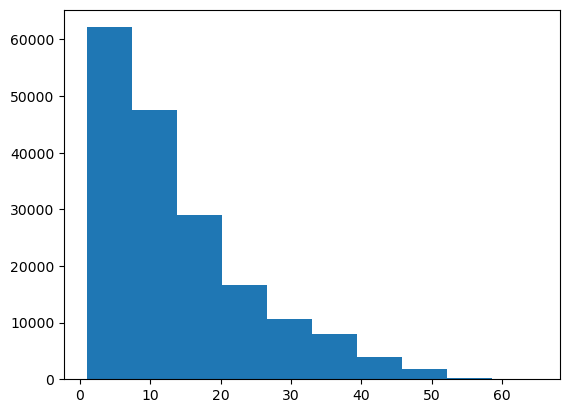

In [28]:
import matplotlib.pyplot as plt
plt.hist(dataLen, bins=10)
plt.show()

In [29]:
train_ids

[[198,
  2,
  964,
  985,
  3,
  493,
  1112,
  3,
  4341,
  61,
  2,
  358,
  1323,
  241,
  131,
  4596,
  193,
  20,
  246],
 [1639, 6, 1, 104, 34, 3, 3259],
 [14, 8, 416, 2956, 45, 2, 6, 353, 161, 528, 63, 54],
 [23, 3, 257, 8, 1992, 807, 6, 1],
 [4709, 1022, 1, 252, 318, 510, 1500, 11],
 [498,
  28,
  26,
  391,
  39,
  8073,
  2423,
  1,
  5492,
  12,
  5013,
  4109,
  8073,
  6718,
  424,
  7839,
  1368,
  1],
 [53,
  9,
  6,
  229,
  812,
  22,
  52,
  181,
  524,
  2174,
  9,
  1288,
  2310,
  3344,
  6,
  146,
  546,
  309,
  18,
  1,
  8889,
  753],
 [14,
  168,
  1832,
  4,
  1,
  2809,
  8,
  3,
  188,
  5381,
  2957,
  3319,
  5,
  12,
  125,
  1,
  297,
  3,
  1,
  529,
  496,
  31],
 [54, 307, 5703, 298, 552, 4, 1, 24, 6, 3854],
 [278, 6, 197, 119, 1653, 11],
 [14, 83, 825, 1227, 112, 8, 74],
 [8579, 470, 97, 8315, 2, 1429, 4455, 26, 37, 2610, 2880, 1289, 19, 7, 2789],
 [54, 7385, 29, 486, 75, 1],
 [183, 2, 4062, 1, 434, 96, 176, 339, 45, 2, 41, 58],
 [232, 18, 1, 1256,

In [30]:
max_length = 50
pad_id = token_to_id['<pad>']
train_ids = pad_sequences(train_ids, max_length, pad_id)
test_ids = pad_sequences(test_ids, max_length, pad_id)

In [31]:
print(train_ids[0])
print(test_ids[0])

[ 198    2  964  985    3  493 1112    3 4341   61    2  358 1323  241
  131 4596  193   20  246    0    0    0    0    0    0    0    0    0
    0    0    0    0    0    0    0    0    0    0    0    0    0    0
    0    0    0    0    0    0    0    0]
[ 346   50 1974    1   42   90  433 1260    3 9070  657  145  429 1295
  126   19 4230   27   26   71   41   31    0    0    0    0    0    0
    0    0    0    0    0    0    0    0    0    0    0    0    0    0
    0    0    0    0    0    0    0    0]


In [32]:
import torch
from torch.utils.data import TensorDataset, DataLoader

In [33]:
train_ids = torch.tensor(train_ids)
test_ids = torch.tensor(test_ids)

In [34]:
train['target'].values

array([0, 1, 1, ..., 0, 0, 1])

In [35]:
train_labels = torch.tensor(train['target'].values, dtype=torch.float32)
test_labels = torch.tensor(test['target'].values, dtype=torch.float32)

In [36]:
train_dataset = TensorDataset(train_ids, train_labels)
test_dataset = TensorDataset(test_ids, test_labels)

In [37]:
train_loader = DataLoader(train_dataset, batch_size=16, shuffle=True)
test_loader = DataLoader(test_dataset, batch_size=16, shuffle=False)

for i,j in train_loader:
    i = i
    j = i
    break

print(i.shape)
print(j.shape)

torch.Size([16, 50])
torch.Size([16, 50])


In [38]:
from torch import optim

In [39]:
import torch.nn as nn

class SentenceClassifier(nn.Module):
    def __init__(self,
                 n_vocab,
                 hidden_dim,
                 embedding_dim,
                 n_layers, 
                 dropout = 0.5,
                 bidirectional = True,
                 model_type = 'lstm'):
        super().__init__()

        self.embedding = nn.Embedding(
            num_embeddings=n_vocab,
            embedding_dim = embedding_dim,
            padding_idx= 0)
        
        if model_type =='rnn':
            self.model = nn.RNN(
                input_size=embedding_dim,
                hidden_size = hidden_dim,
                num_layers= n_layers,
                bidirectional=bidirectional,
                dropout=dropout,
                batch_first=True)
    
        elif model_type == "lstm":
            self.model = nn.LSTM(
                input_size=embedding_dim,
                hidden_size = hidden_dim,
                num_layers= n_layers,
                bidirectional=bidirectional,
                dropout=dropout,
                batch_first=True )
            
        if bidirectional:
            self.classifier = nn.Linear(hidden_dim * 2, 1)
            
        else:
            self.classifier = nn.Linear(hidden_dim, 1)
        self.dropout = nn.Dropout(dropout)

    def forward(self, inputs):
        embeddings =self.embedding(inputs)
        output, _ = self.model(embeddings)
        last_output = output[:, -1, :]
        last_output = self. dropout(last_output)
        logits = self. classifier(last_output)
        return logits

In [30]:
cnt_vocab = len(token_to_id)
hidden_dim = 64
embedding_dim = 128
n_layers =2

device = torch.device('cuda' if torch.cuda.is_available() else "cpu")
classifier = SentenceClassifier(n_vocab=cnt_vocab, hidden_dim=hidden_dim, embedding_dim=embedding_dim, n_layers=n_layers).to(device)
criterion = nn.BCEWithLogitsLoss().to(device)
optimizer = optim.RMSprop(classifier.parameters(), lr=0.001)

c:\Users\KDP-23\anaconda3\envs\TEXT_018\lib\site-packages\tqdm\auto.py:21: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm


In [31]:
def train(model, dataset, criterion, optimizer, device, interval):
    model.train()
    losses= list()
    corrects = list()

    for step, (input_ids, labels) in enumerate(dataset):
        input_ids = input_ids.to(device)
        labels = labels.to(device).unsqueeze(1)

        logits = model(input_ids)
        loss = criterion(logits, labels)
        losses.append(loss.item())

        yhat = torch.sigmoid(logits)>.5
        corrects.extend(torch.eq(yhat, labels).cpu().tolist())

        optimizer.zero_grad()
        loss.backward()
        optimizer.step()

        if step % interval ==0:
            print(f'Train Loss {step} : {np.mean(losses)}, Train Accuracy : {np.mean(corrects)}')

In [32]:
def test(model, dataset, criterion, device):
    model.eval()
    losses_V= list()
    corrects_V = list()

    for step, (input_ids, labels) in enumerate(dataset):
        input_ids = input_ids.to(device)
        labels = labels.to(device).unsqueeze(1)

        logits = model(input_ids)
        loss = criterion(logits, labels)
        losses_V.append(loss.item())
        yhat = torch.sigmoid(logits)>.5
        corrects_V.extend(torch.eq(yhat, labels).cpu().tolist())
        
    print(f'Val Loss : {np.mean(losses_V)}, Val Accuracy : {np.mean(corrects_V)}')

    return max(corrects_V)

In [46]:
epochs = 5
interval = 500
BEST_HISTORY = 0

for epoch in range(epochs):
    train(classifier, train_loader, criterion, optimizer, device, interval)
    score = test(classifier, train_loader, criterion, device)

    # 모델 폴더가 없다면 생성
    if not os.path.exists('model/'):
        os.mkdir('model/')

    if BEST_HISTORY < max(score):
        BEST_HISTORY = max(score)
        torch.save(classifier,f'model/best_model{epoch}.pth')
                

Train Loss 0 : 0.36330991983413696, Train Accuracy : 0.9375
Train Loss 500 : 0.2967969403934931, Train Accuracy : 0.8843562874251497
Train Loss 1000 : 0.3005074630533303, Train Accuracy : 0.8828046953046953
Train Loss 1500 : 0.30170491937768806, Train Accuracy : 0.880954363757495
Train Loss 2000 : 0.3027852262542032, Train Accuracy : 0.8800287356321839
Train Loss 2500 : 0.3028782991977667, Train Accuracy : 0.8799480207916833
Train Loss 3000 : 0.3026792960410881, Train Accuracy : 0.8799775074975008
Train Loss 3500 : 0.30255712585625344, Train Accuracy : 0.8799450157097972
Train Loss 4000 : 0.3022068593086816, Train Accuracy : 0.8800299925018745
Train Loss 4500 : 0.3013553000068703, Train Accuracy : 0.8803876916240836
Train Loss 5000 : 0.30030012171893533, Train Accuracy : 0.8808113377324535
Train Loss 5500 : 0.3004324519771448, Train Accuracy : 0.8808625704417379
Train Loss 6000 : 0.29998269637897945, Train Accuracy : 0.88091568071988
Train Loss 6500 : 0.30003164297205004, Train Accurac

In [34]:
token_to_embedding = dict()
embedding_matrix = classifier.embedding.weight.detach().cpu().numpy()

for word, emb in zip(vocab, embedding_matrix):
    token_to_embedding[word] = emb

token = vocab[1000]
print( token, token_to_embedding[token])

좋을 [ 1.0502418  -1.3569032   0.35602826 -0.28863838  0.79402757 -0.30080488
 -1.1961846   0.8403869  -0.9125511   1.0320877  -1.7748883   1.5176041
  1.2260131   0.05851819  2.094608    0.6711191   0.07240187  3.5775654
  0.07301829  0.8603854  -1.4912344   0.99826974 -1.0218769  -2.5005994
 -0.3624968   0.27783954  1.100926    0.3626903   0.06084219 -0.67818874
  1.6283004  -0.78765184  0.84055597  0.5065687   1.8062996   1.3668011
  0.49324352 -1.1016312  -0.63528657  0.8094393  -1.030557   -0.36087373
  1.6973813   0.04116644 -0.7348813   1.6555367  -0.26089668 -0.28673086
  0.29510263 -1.0986212   1.0569582  -0.54876244  0.8060182   0.8234363
  0.1295791  -0.95096594 -0.25579548 -1.8803147   1.0038843  -0.9165852
  1.1259074   0.26214728 -0.7040964  -1.3286624  -0.00931925  0.57887876
 -0.3953822  -1.5911369   1.8658906  -1.2291116   0.9058737  -0.11914983
 -1.4702809  -0.5529057  -0.01766878 -0.5479758  -1.2806381  -2.579642
 -1.5051394   0.05508131  0.19980668  1.7115237  -0.8484

In [ ]:
fg, axes=plt.subplots(1,2, figsize=(10,5), sharex=True, sharey=True)
axes[0].plot(range(1, epochs+1), loss_history[0][:6], label='Train')
axes[0].plot(range(1, epochs+1), loss_history[1][:6], label='Val')
axes[0].grid()
axes[0].legend()
axes[0].set_xlabel("Epoch")
axes[0].set_ylabel("Loss")
axes[0].set_title("LOSS")

axes[1].plot(range(1, 6), score_history[0][:6], label='Train')
axes[1].plot(range(1, 6), score_history[1][:6], label='Val')
axes[1].grid()
axes[1].legend()
axes[1].set_xlabel("Epoch")
axes[1].set_ylabel("score")
axes[1].set_title("score")
plt.tight_layout()
plt.show()

-------------------------
#### 학습된 모델로부터 임베딩 추출

In [35]:
from gensim.models import Word2Vec

In [36]:
word2vec= Word2Vec.load('../models/word2vec.model')
init_embeddings = np.zeros((cnt_vocab, embedding_dim))

In [37]:
for index, token in id_to_token.items():
    if token not in ['<pad>','<unk>']:
        if token in word2vec.wv:  # Word2Vec에 토큰이 있는지 확인
            init_embeddings[index] = word2vec.wv[token]
        else:
            # 토큰이 Word2Vec에 없으면 임베딩을 특정 값으로 초기화 (예: 평균값이나 무작위)
            init_embeddings[index] = np.random.normal(size=(embedding_dim,))
            # 또는 zeros로 초기화하여 임베딩 정보를 주지 않음
            # init_embeddings[index] = np.zeros(embedding_dim)


In [38]:
embedding_layer = nn.Embedding.from_pretrained(
    torch.tensor(init_embeddings, dtype=torch.float32)
)

In [39]:
class SentenceClassifier1(nn.Module):
    def __init__(self,
                 n_vocab,
                 hidden_dim,
                 embedding_dim,
                 n_layers, 
                 dropout = 0.5,
                 bidirectional = True,
                 model_type = 'lstm',
                 pretrained_embedding = None):
        
        super().__init__()

        self.embedding = nn.Embedding(
            num_embeddings=n_vocab,
            embedding_dim = embedding_dim,
            padding_idx= 0)
        
        if model_type =='rnn':
            self.model = nn.RNN(
                input_size=embedding_dim,
                hidden_size = hidden_dim,
                num_layers= n_layers,
                bidirectional=bidirectional,
                dropout=dropout,
                batch_first=True)
    
        elif model_type == "lstm":
            self.model = nn.LSTM(
                input_size=embedding_dim,
                hidden_size = hidden_dim,
                num_layers= n_layers,
                bidirectional=bidirectional,
                dropout=dropout,
                batch_first=True )
            
        if bidirectional:
            self.classifier = nn.Linear(hidden_dim * 2, 1)
            
        else:
            self.classifier = nn.Linear(hidden_dim, 1)
        self.dropout = nn.Dropout(dropout)

        if pretrained_embedding is not None:
            self.embedding = nn.Embedding.from_pretrained(
                torch.tensor(pretrained_embedding, dtype=torch.float32))
        
        
        else :
            self.embedding = nn.Embedding(
                num_embeddings=cnt_vocab,
                embedding_dim=embedding_dim,
                padding_idx= 0)

    def forward(self, inputs):
        embeddings =self.embedding(inputs)
        output, _ = self.model(embeddings)
        last_output = output[:, -1, :]
        last_output = self. dropout(last_output)
        logits = self. classifier(last_output)
        return logits

In [40]:
classifier = SentenceClassifier1(n_vocab=cnt_vocab, hidden_dim=hidden_dim, embedding_dim=embedding_dim, n_layers=n_layers, pretrained_embedding=init_embeddings).to(device)
criterion = nn.BCEWithLogitsLoss().to(device)
optimizer = optim.RMSprop(classifier.parameters(), lr=0.001)

In [41]:
epochs= 5
interval = 500
BEST_HISTORY_W = 0

In [42]:
for epoch in range(epochs):
    train(classifier, train_loader, criterion, optimizer, device, interval)
    score = test(classifier, train_loader, criterion, device)
    
    # 모델 폴더가 없다면 생성
    if not os.path.exists('model/'):
        os.mkdir('model/')

    if BEST_HISTORY_W < max(score):
        BEST_HISTORY_W = max(score)
        torch.save(classifier,f'model/best_model{epoch}.pth')

Train Loss 0 : 0.6904075145721436, Train Accuracy : 0.5625
Train Loss 500 : 0.6892769134449149, Train Accuracy : 0.5329341317365269
Train Loss 1000 : 0.6857378757321513, Train Accuracy : 0.548513986013986
Train Loss 1500 : 0.6832473351509074, Train Accuracy : 0.5500916055962691


KeyboardInterrupt: 